In [ ]:
# default_exp diffusion_and_kld_embedder
from nbdev.showdoc import *
import numpy as np
import matplotlib.pyplot as plt
import torch
import directed_graphs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Diffusion Distance Based Loss

Explorations and visualizations.

In this notebook, we'll subclass the 05c01a FETrainer and tailor it to the Mean Squared Error loss function in MFE.

In [ ]:
# export
import torch
from directed_graphs.diffusion_distance_flow_embedder import compare_distance_matrices
import matplotlib.pyplot as plt
from directed_graphs.multiscale_flow_embedder import MultiscaleDiffusionFlowEmbedder
from directed_graphs.flow_embedding_training_utils import FETrainer, visualize_points, save_embedding_visualization
class DiffusionDistanceFlowEmbedder(FETrainer):
    def __init__(self, X, flows, labels, device = torch.device("cuda" if torch.cuda.is_available() else "cpu")):
        super().__init__(X, flows, labels, device = device)
        self.vizfiz = [
            save_embedding_visualization,
            visualize_points,
            compare_distance_matrices,
        ]
        loss_weights = {
            "diffusion":1,
            "smoothness":0,
            "reconstruction":0,
            "diffusion map regularization":20,
            "flow cosine loss": 0,
        }
        self.FE = MultiscaleDiffusionFlowEmbedder(
            X = X,
            ts = [1],
            flows = flows,
            sigma_graph = 1,
            flow_strength_graph = 1,
            device = device,
            use_embedding_grid = False,
            loss_weights = loss_weights,
            k_dmap = 18,
            t_dmap = 50,
            dmap_coords_to_use = 2,
            
        ).to(device)
        # visualize diffusion map
        plt.scatter(self.FE.diff_coords[:,0].cpu().numpy(),self.FE.diff_coords[:,1].cpu().numpy(),c=labels)
        self.title = "Diffusion Distance FE"
        

In [ ]:
from directed_graphs.datasets import directed_swiss_roll_sklearn, plot_directed_3d
X, flow, labels = directed_swiss_roll_sklearn(num_nodes=2000)

In [ ]:
X = torch.tensor(X).float().to(device)
flow = torch.tensor(flow).float().to(device)
X = X.float().to(device)
flow = flow.float().to(device)

/gpfs/loomis/project/krishnaswamy_smita/kjm76/directed_graphs/directed_graphs/utils.py:12: UserWarning: Sparsifying input to bsr_array
  warnings.warn("Sparsifying input to bsr_array")


using sigma =  2.298348
[1.0000014 +0.j 0.9774393 +0.j 0.9697032 +0.j 0.954148  +0.j
 0.94269323+0.j]


/gpfs/loomis/project/krishnaswamy_smita/kjm76/conda_envs/flowembed/lib/python3.9/site-packages/matplotlib/transforms.py:775: ComplexWarning: Casting complex values to real discards the imaginary part
  points = np.asarray(points, float)


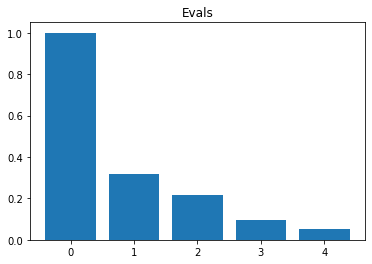

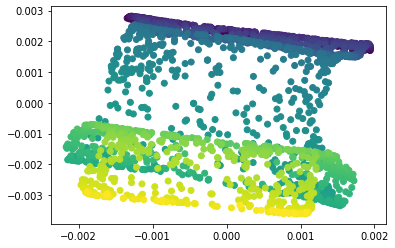

In [ ]:
BOBO_FET = DiffusionDistanceFlowEmbedder(X, flow, labels = labels, device = device)

  0%|          | 0/100 [00:00<?, ?it/s]

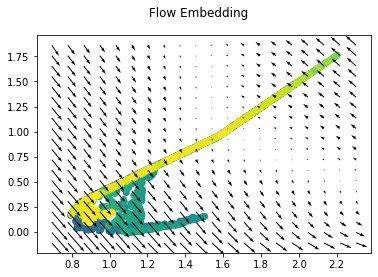

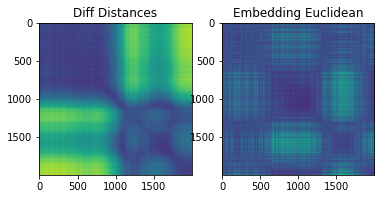

  1%|          | 1/100 [00:05<09:05,  5.51s/it]

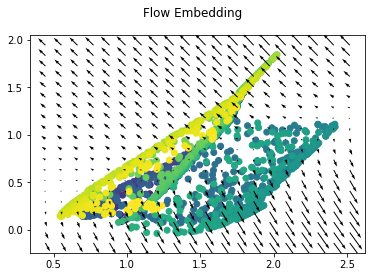

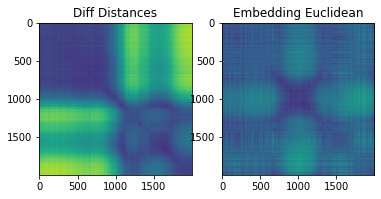

  2%|▏         | 2/100 [00:10<08:54,  5.45s/it]

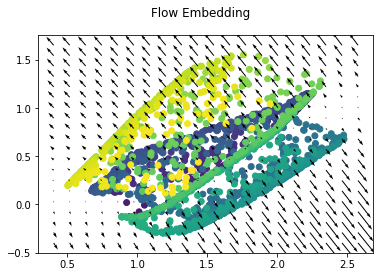

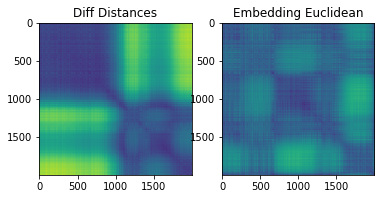

  3%|▎         | 3/100 [00:16<08:47,  5.44s/it]

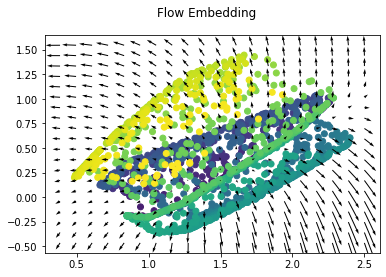

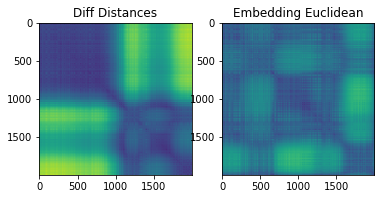

  4%|▍         | 4/100 [00:21<08:42,  5.45s/it]

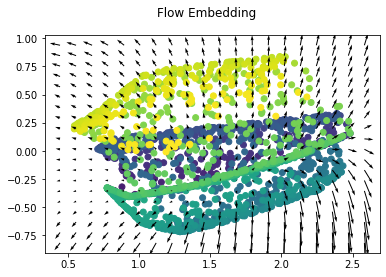

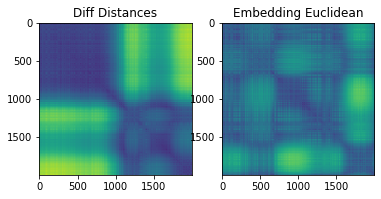

  5%|▌         | 5/100 [00:27<08:37,  5.45s/it]

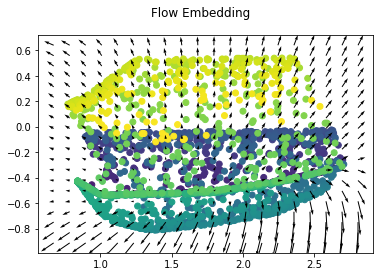

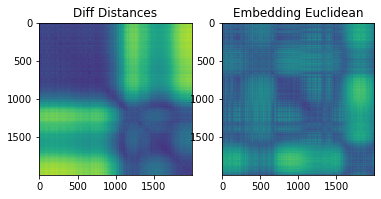

  6%|▌         | 6/100 [00:32<08:41,  5.54s/it]

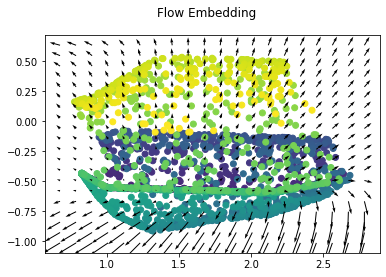

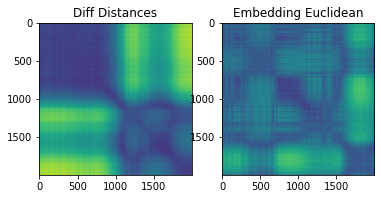

  7%|▋         | 7/100 [00:38<08:33,  5.53s/it]

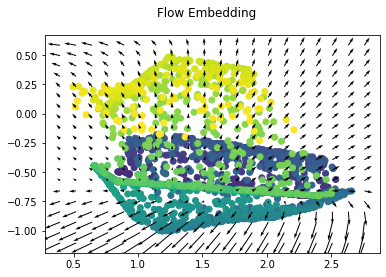

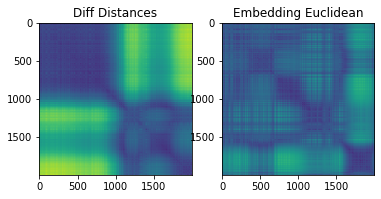

  8%|▊         | 8/100 [00:43<08:25,  5.50s/it]

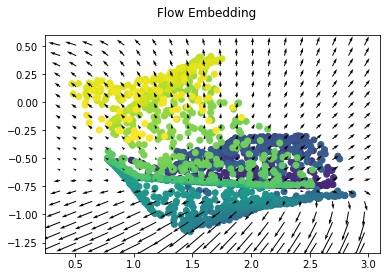

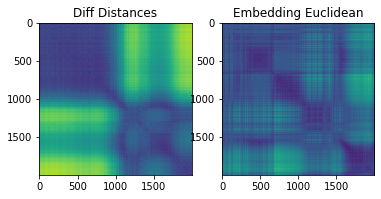

  9%|▉         | 9/100 [00:49<08:19,  5.48s/it]

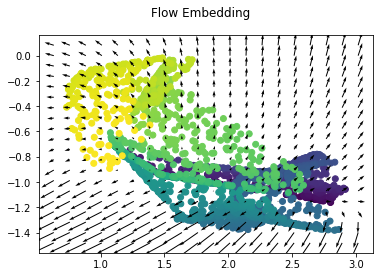

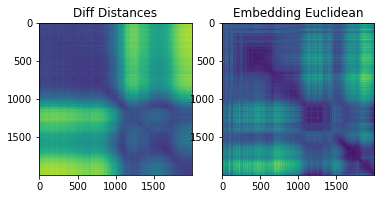

 10%|█         | 10/100 [00:54<08:13,  5.48s/it]

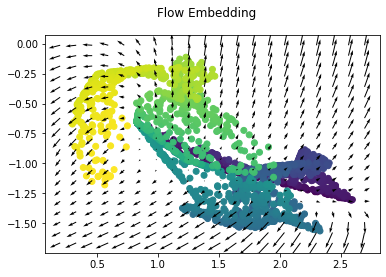

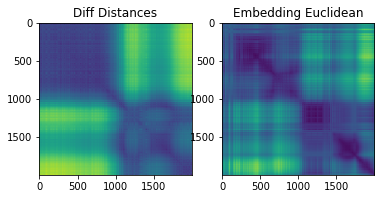

 11%|█         | 11/100 [01:00<08:08,  5.49s/it]

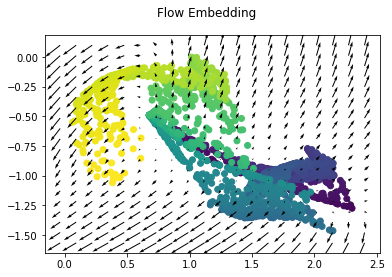

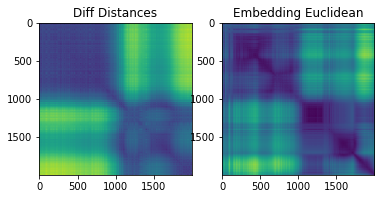

 12%|█▏        | 12/100 [01:05<08:03,  5.49s/it]

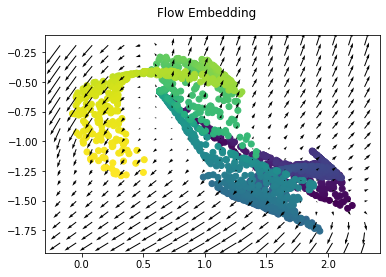

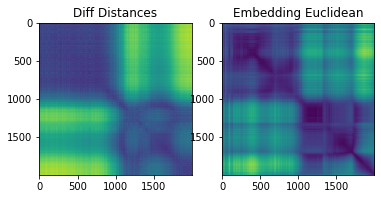

 13%|█▎        | 13/100 [01:11<07:56,  5.48s/it]

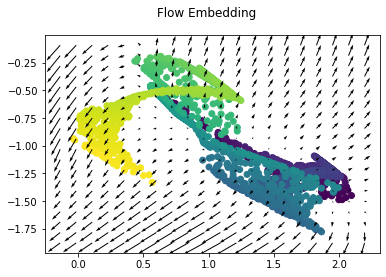

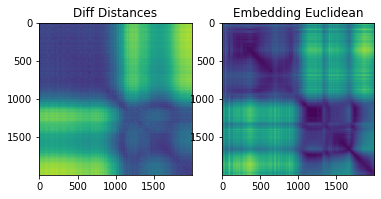

 14%|█▍        | 14/100 [01:16<07:55,  5.53s/it]

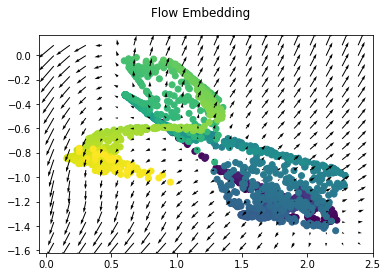

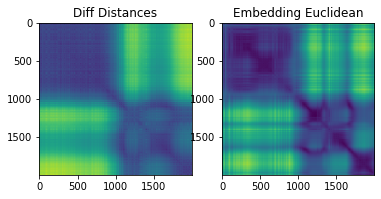

 15%|█▌        | 15/100 [01:22<07:53,  5.58s/it]

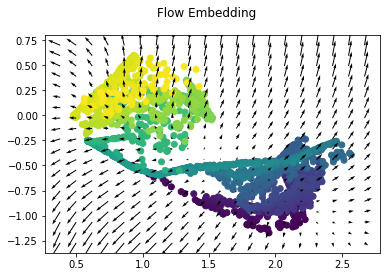

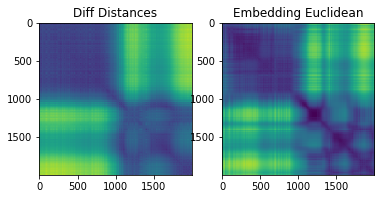

 16%|█▌        | 16/100 [01:28<07:46,  5.55s/it]

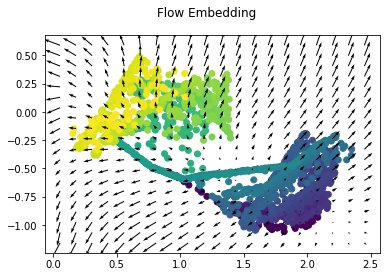

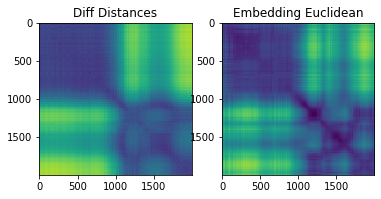

 17%|█▋        | 17/100 [01:33<07:38,  5.52s/it]

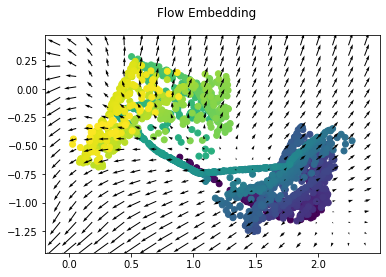

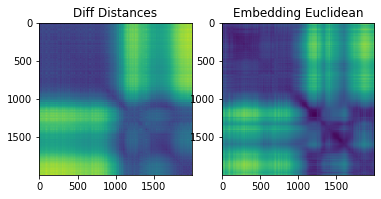

 18%|█▊        | 18/100 [01:39<07:30,  5.50s/it]

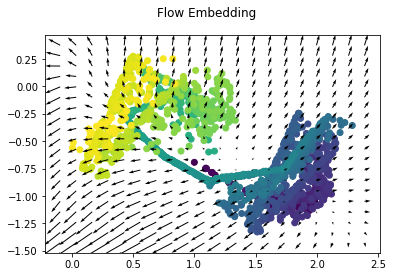

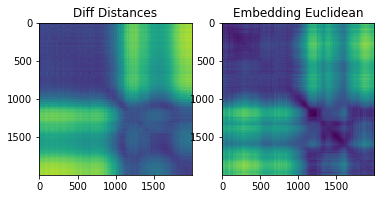

 19%|█▉        | 19/100 [01:44<07:24,  5.49s/it]

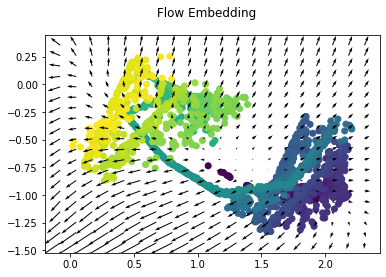

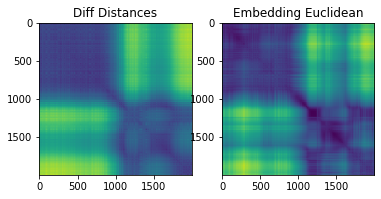

 20%|██        | 20/100 [01:49<07:18,  5.49s/it]

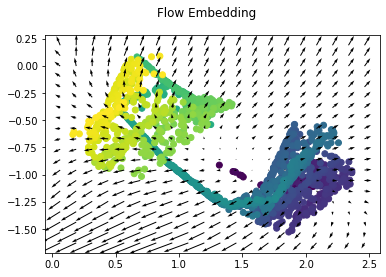

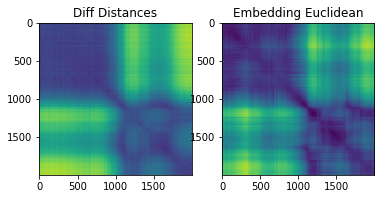

 21%|██        | 21/100 [01:55<07:12,  5.48s/it]

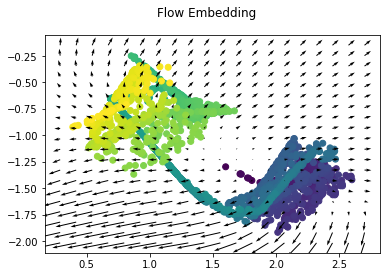

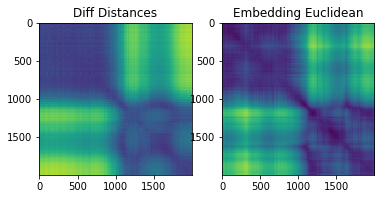

 22%|██▏       | 22/100 [02:00<07:07,  5.48s/it]

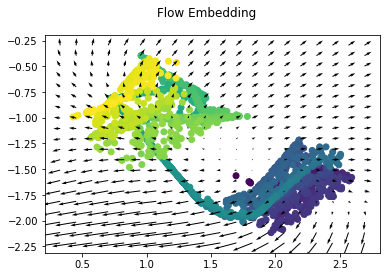

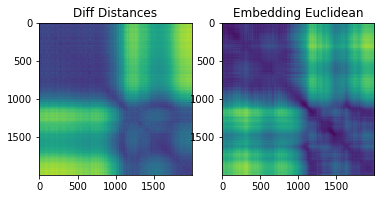

 23%|██▎       | 23/100 [02:06<07:07,  5.56s/it]

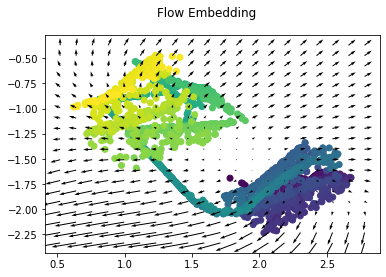

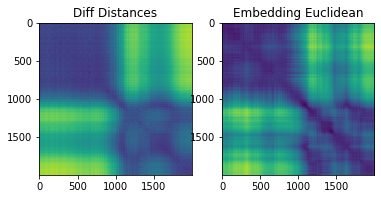

 24%|██▍       | 24/100 [02:12<06:59,  5.52s/it]

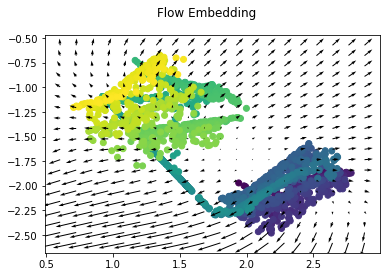

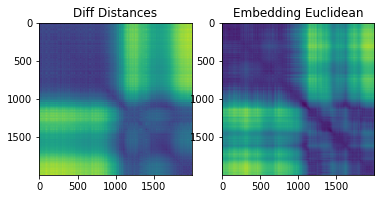

 25%|██▌       | 25/100 [02:17<06:52,  5.50s/it]

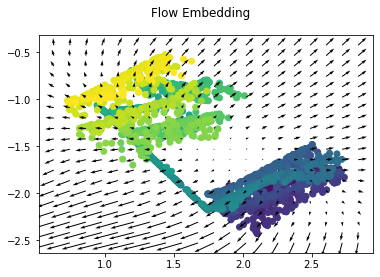

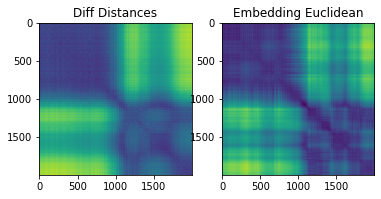

 26%|██▌       | 26/100 [02:22<06:45,  5.48s/it]

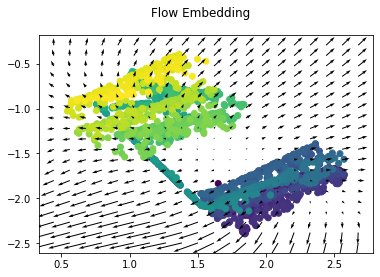

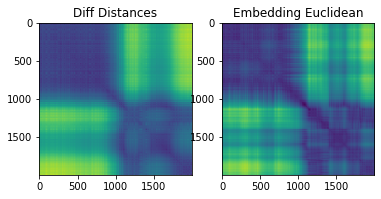

 27%|██▋       | 27/100 [02:28<06:39,  5.47s/it]

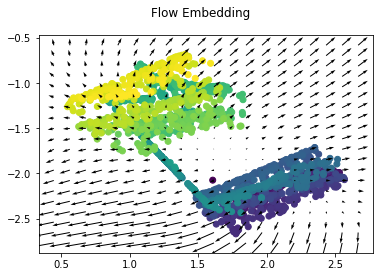

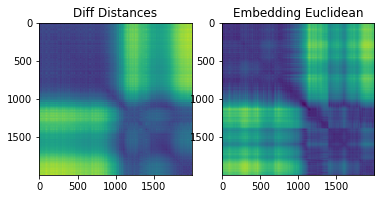

 28%|██▊       | 28/100 [02:33<06:33,  5.47s/it]

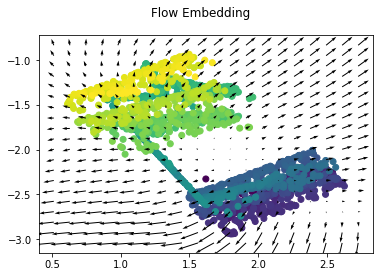

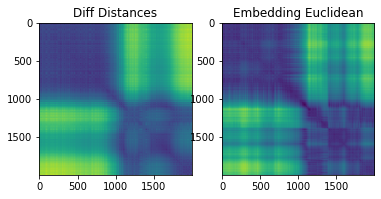

 29%|██▉       | 29/100 [02:39<06:27,  5.46s/it]

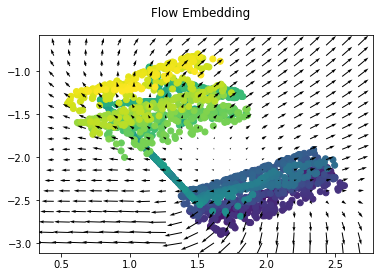

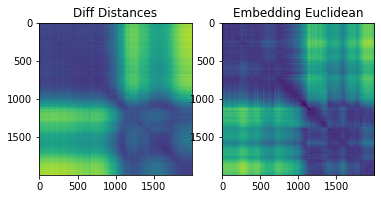

 30%|███       | 30/100 [02:44<06:21,  5.45s/it]

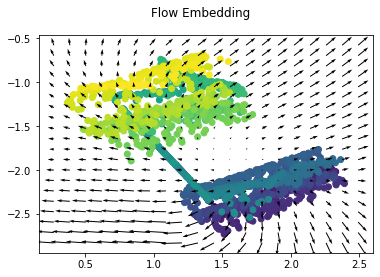

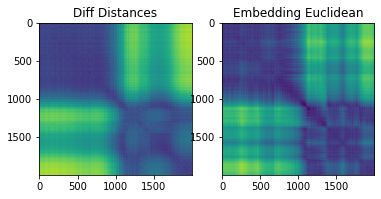

 31%|███       | 31/100 [02:50<06:15,  5.44s/it]

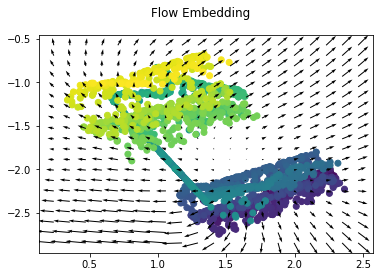

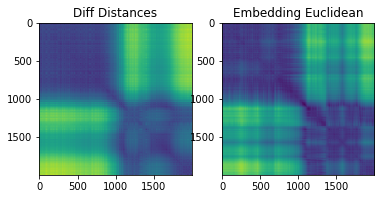

 32%|███▏      | 32/100 [02:55<06:15,  5.52s/it]

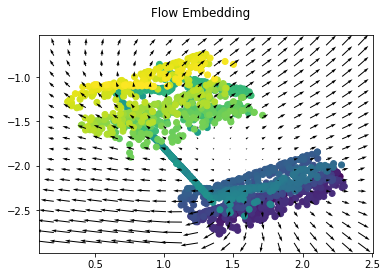

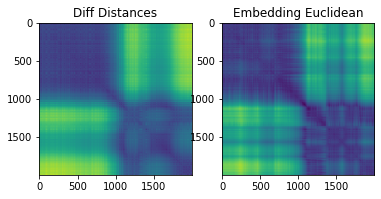

 33%|███▎      | 33/100 [03:01<06:07,  5.48s/it]

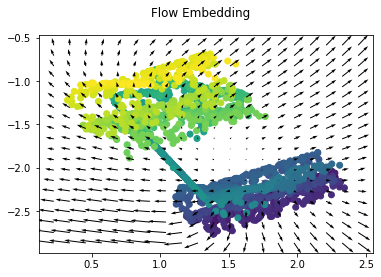

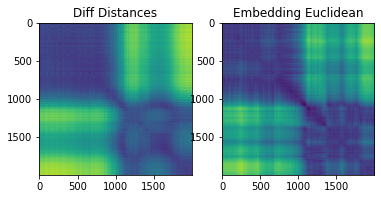

 34%|███▍      | 34/100 [03:06<06:01,  5.47s/it]

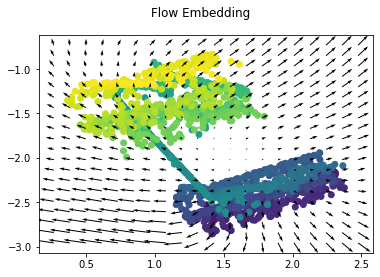

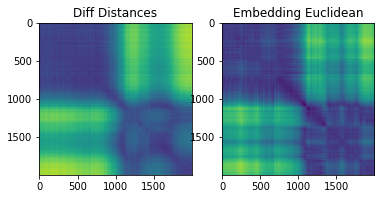

 35%|███▌      | 35/100 [03:12<05:54,  5.46s/it]

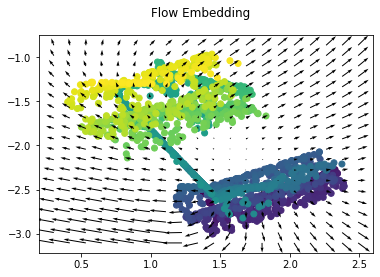

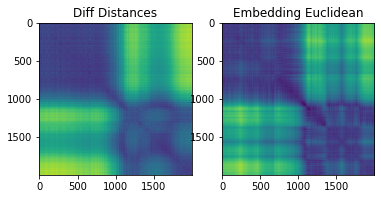

 36%|███▌      | 36/100 [03:17<05:48,  5.45s/it]

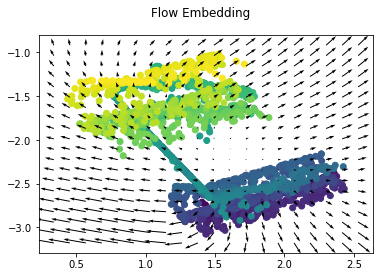

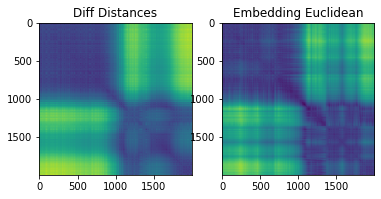

 37%|███▋      | 37/100 [03:23<05:43,  5.46s/it]

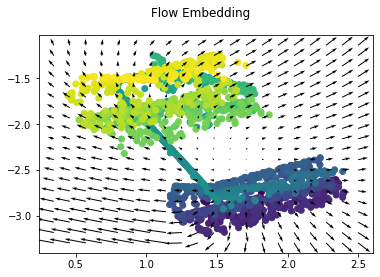

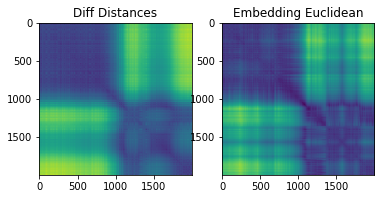

 38%|███▊      | 38/100 [03:28<05:39,  5.48s/it]

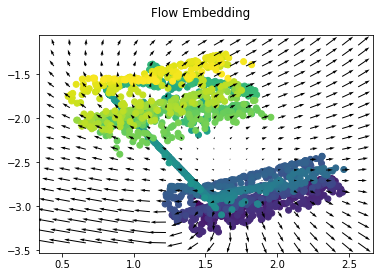

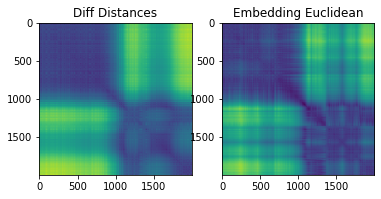

 39%|███▉      | 39/100 [03:34<05:33,  5.47s/it]

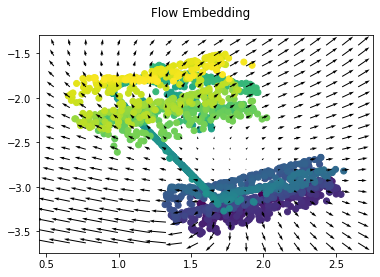

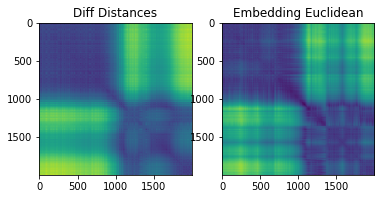

 40%|████      | 40/100 [03:39<05:27,  5.46s/it]

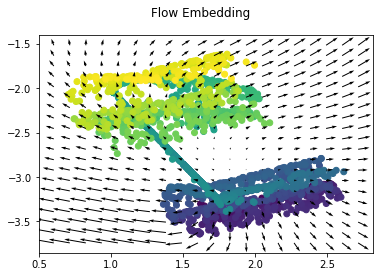

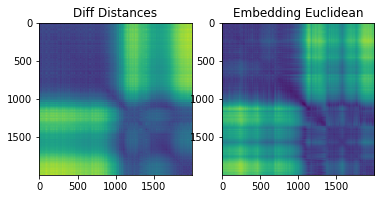

 41%|████      | 41/100 [03:44<05:21,  5.45s/it]

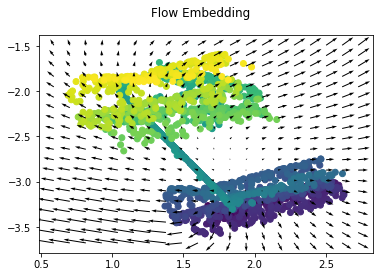

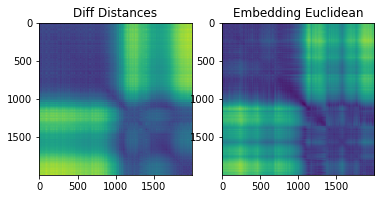

 42%|████▏     | 42/100 [03:50<05:20,  5.53s/it]

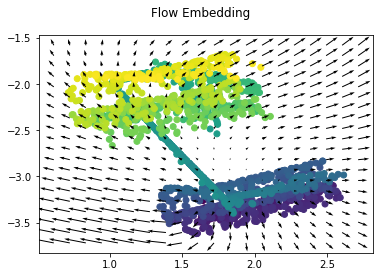

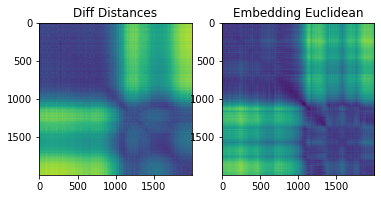

 43%|████▎     | 43/100 [03:56<05:13,  5.51s/it]

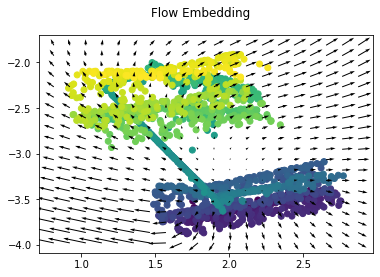

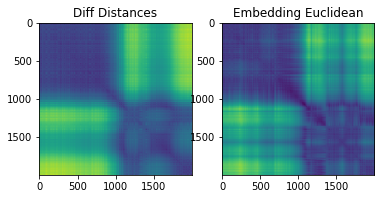

 44%|████▍     | 44/100 [04:01<05:06,  5.48s/it]

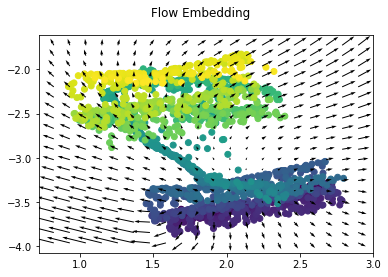

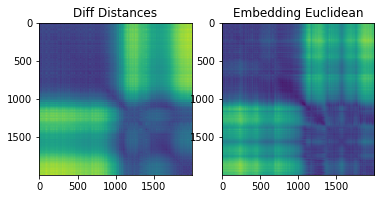

 45%|████▌     | 45/100 [04:06<05:00,  5.46s/it]

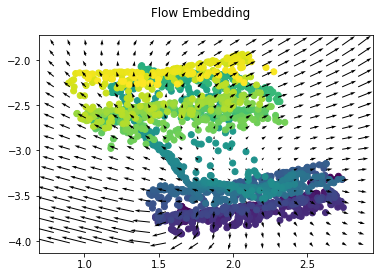

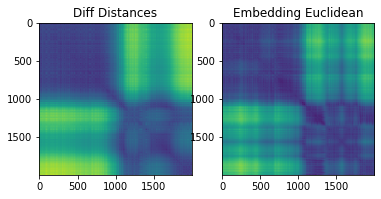

 46%|████▌     | 46/100 [04:12<04:54,  5.45s/it]

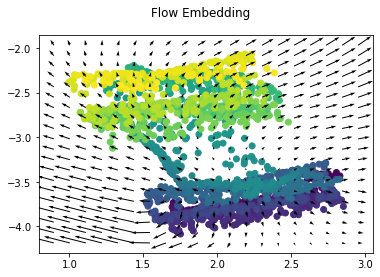

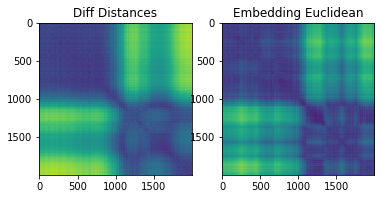

 47%|████▋     | 47/100 [04:17<04:48,  5.44s/it]

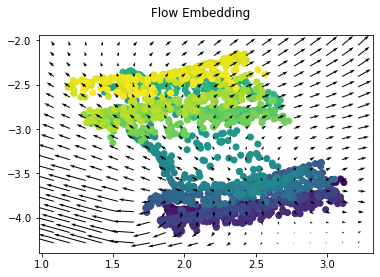

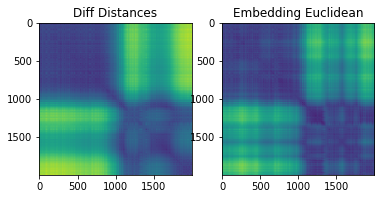

 48%|████▊     | 48/100 [04:23<04:43,  5.45s/it]

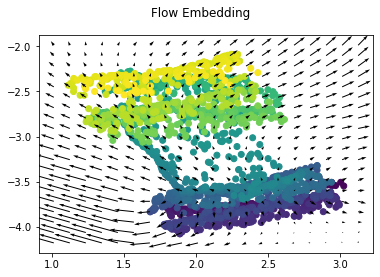

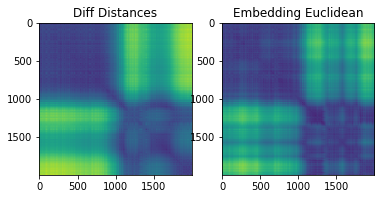

 49%|████▉     | 49/100 [04:28<04:37,  5.44s/it]

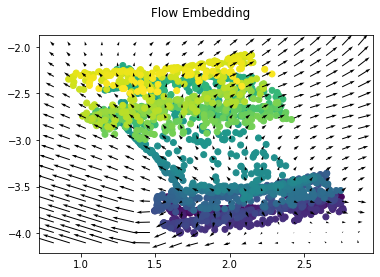

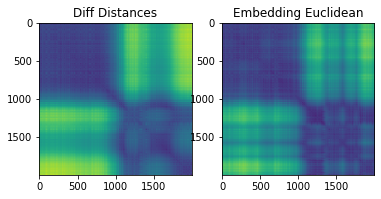

 50%|█████     | 50/100 [04:34<04:32,  5.46s/it]

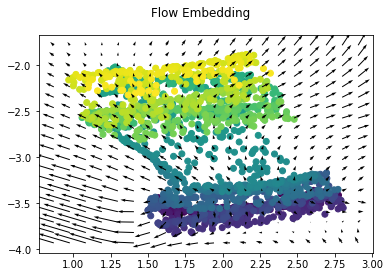

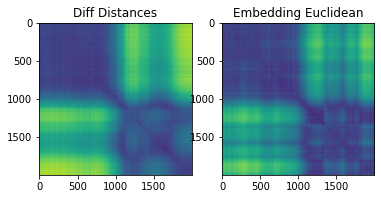

 51%|█████     | 51/100 [04:39<04:31,  5.54s/it]

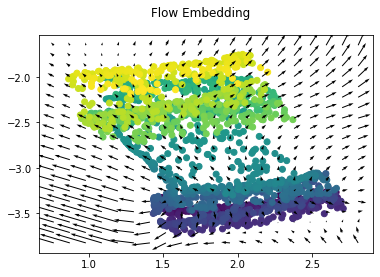

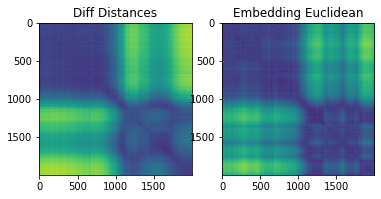

 52%|█████▏    | 52/100 [04:45<04:24,  5.50s/it]

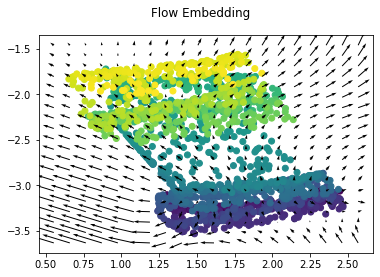

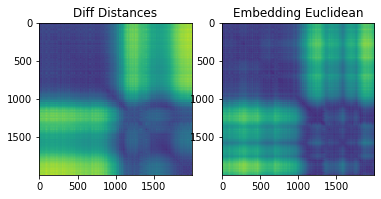

 53%|█████▎    | 53/100 [04:50<04:18,  5.49s/it]

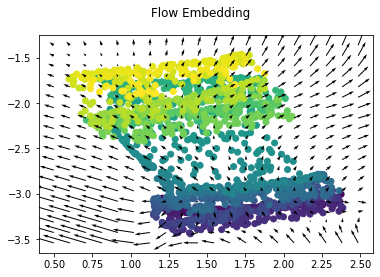

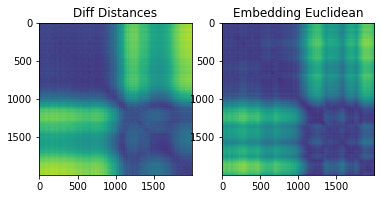

 54%|█████▍    | 54/100 [04:56<04:12,  5.49s/it]

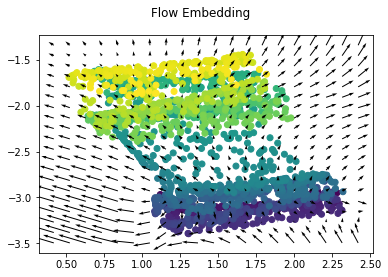

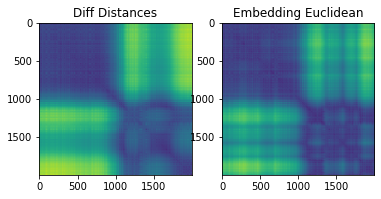

 55%|█████▌    | 55/100 [05:01<04:06,  5.48s/it]

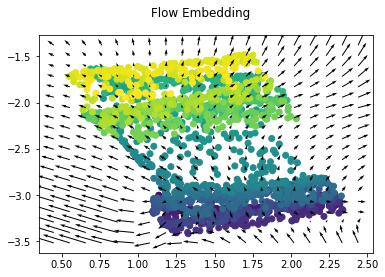

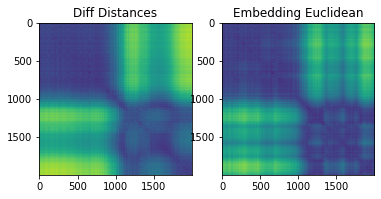

 56%|█████▌    | 56/100 [05:07<04:01,  5.50s/it]

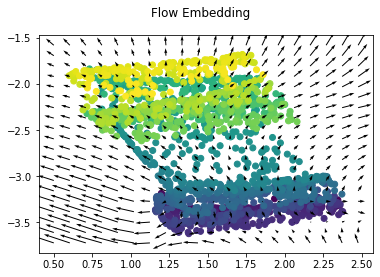

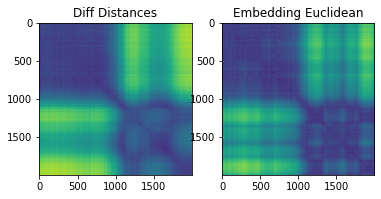

 57%|█████▋    | 57/100 [05:12<03:56,  5.49s/it]

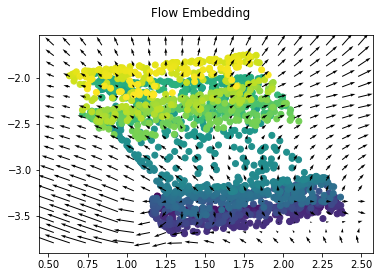

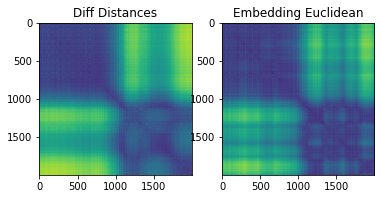

 58%|█████▊    | 58/100 [05:18<03:50,  5.49s/it]

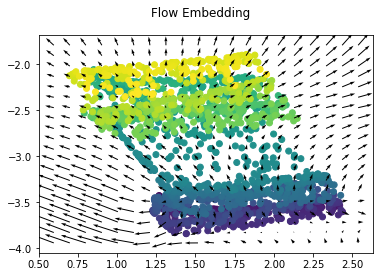

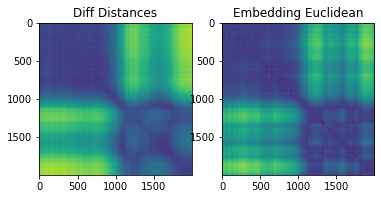

 59%|█████▉    | 59/100 [05:23<03:44,  5.48s/it]

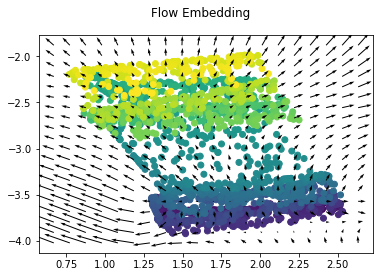

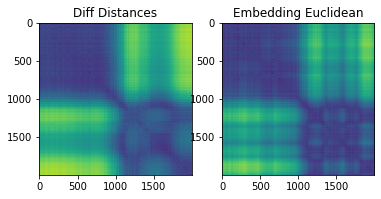

 60%|██████    | 60/100 [05:29<03:43,  5.58s/it]

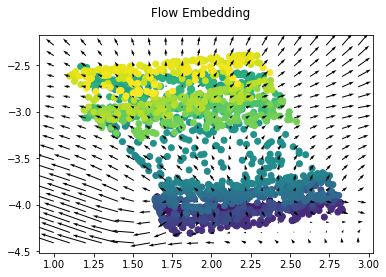

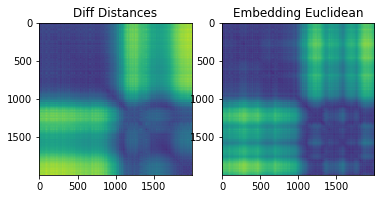

 61%|██████    | 61/100 [05:34<03:36,  5.54s/it]

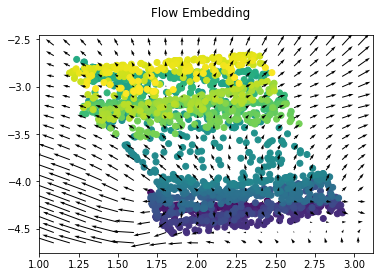

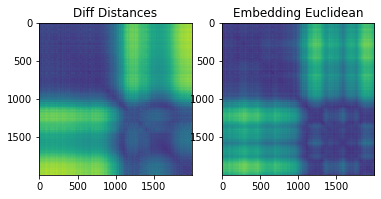

 62%|██████▏   | 62/100 [05:40<03:30,  5.53s/it]

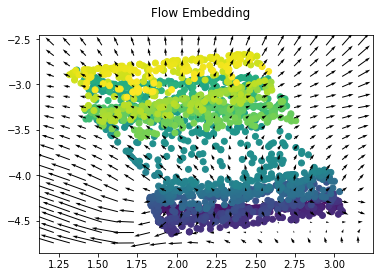

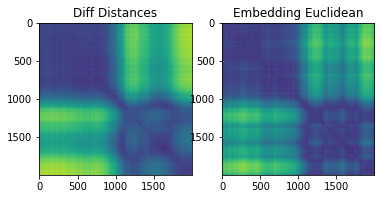

 63%|██████▎   | 63/100 [05:45<03:23,  5.51s/it]

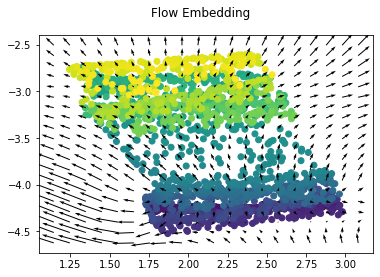

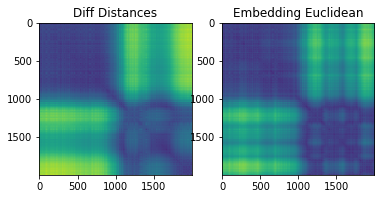

 64%|██████▍   | 64/100 [05:51<03:18,  5.50s/it]

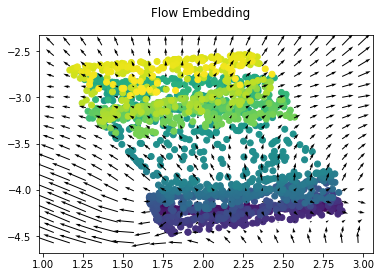

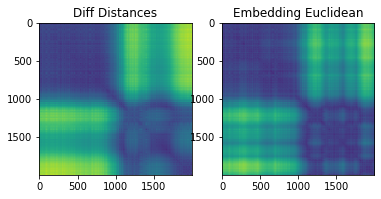

 65%|██████▌   | 65/100 [05:56<03:12,  5.49s/it]

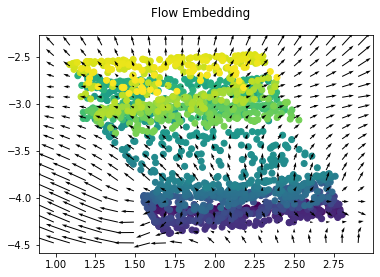

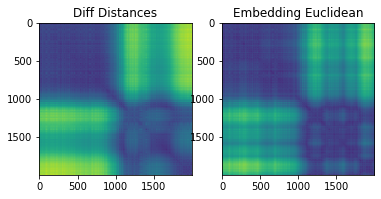

 66%|██████▌   | 66/100 [06:02<03:07,  5.50s/it]

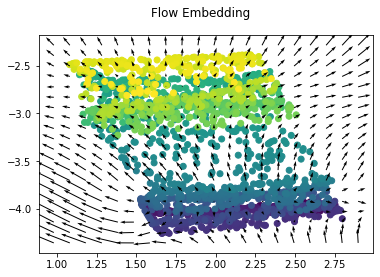

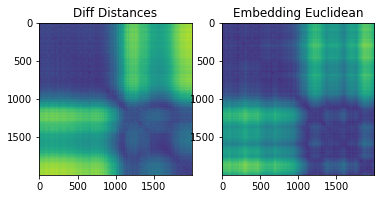

 67%|██████▋   | 67/100 [06:07<03:01,  5.49s/it]

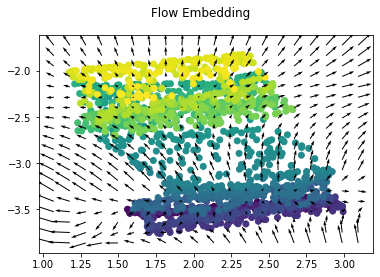

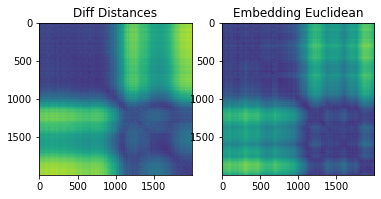

 68%|██████▊   | 68/100 [06:13<02:58,  5.57s/it]

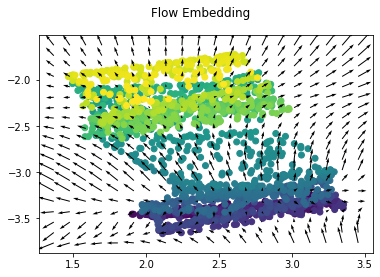

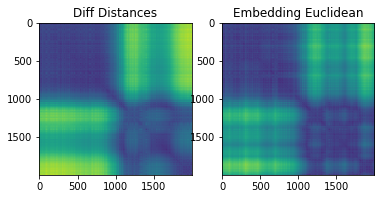

 69%|██████▉   | 69/100 [06:18<02:51,  5.52s/it]

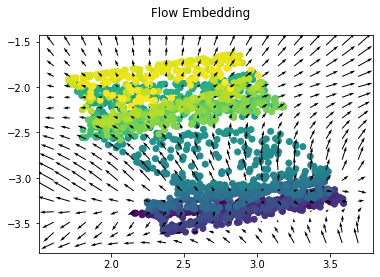

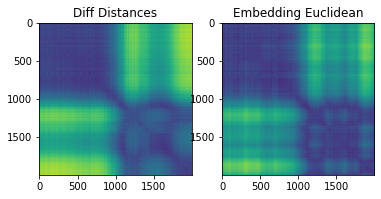

 70%|███████   | 70/100 [06:24<02:45,  5.51s/it]

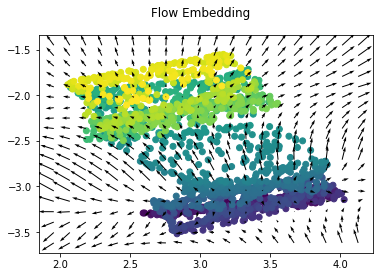

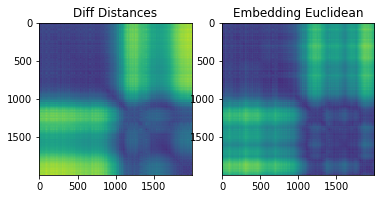

 71%|███████   | 71/100 [06:29<02:39,  5.48s/it]

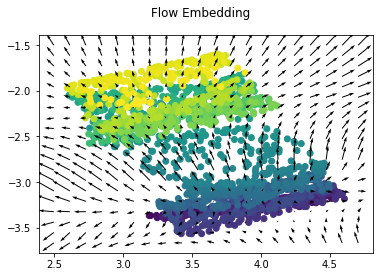

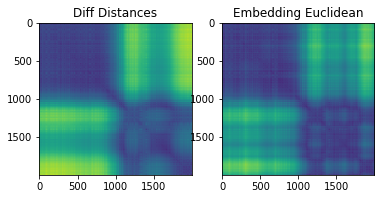

 72%|███████▏  | 72/100 [06:35<02:33,  5.47s/it]

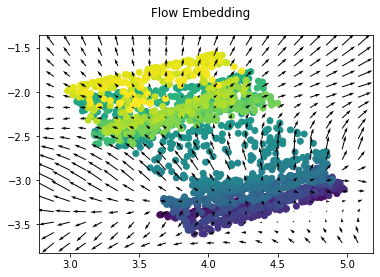

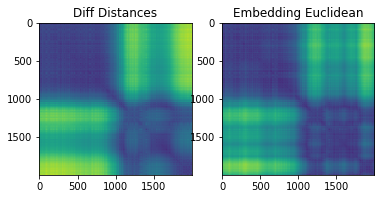

 73%|███████▎  | 73/100 [06:40<02:27,  5.46s/it]

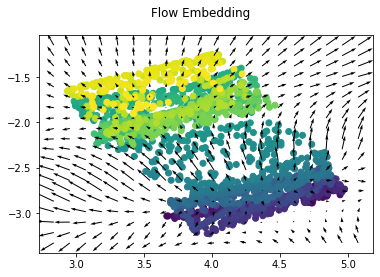

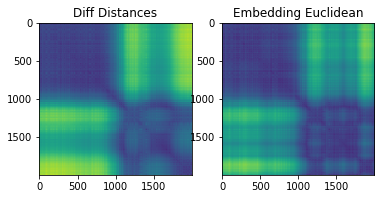

 74%|███████▍  | 74/100 [06:46<02:21,  5.45s/it]

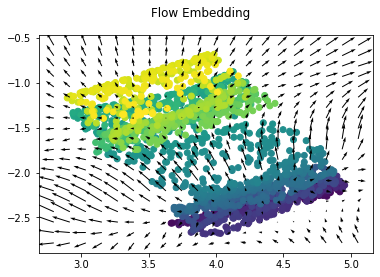

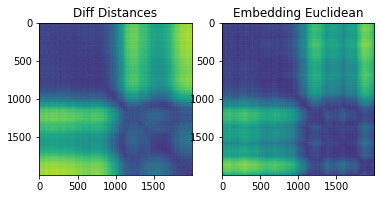

 75%|███████▌  | 75/100 [06:51<02:16,  5.44s/it]

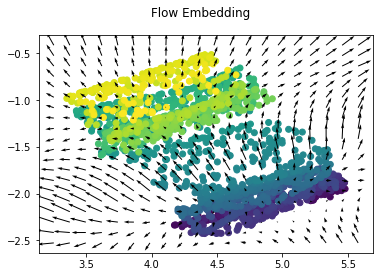

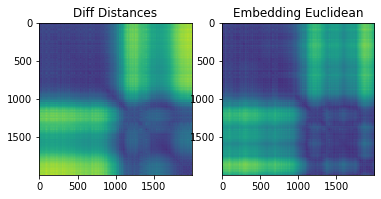

 76%|███████▌  | 76/100 [06:57<02:10,  5.44s/it]

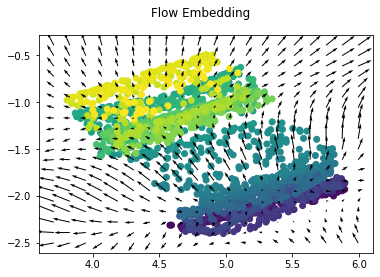

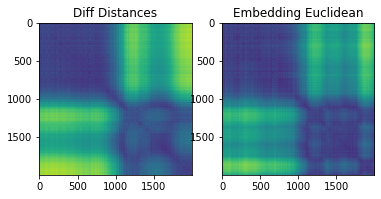

 77%|███████▋  | 77/100 [07:02<02:05,  5.45s/it]

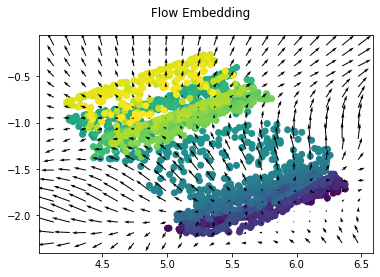

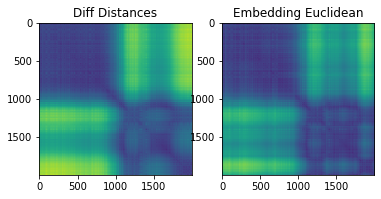

 78%|███████▊  | 78/100 [07:08<02:01,  5.53s/it]

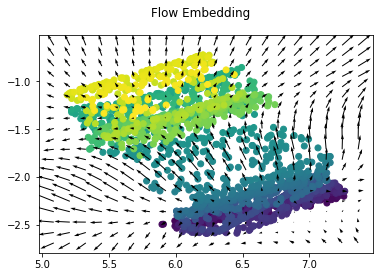

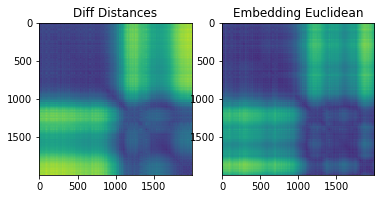

 79%|███████▉  | 79/100 [07:13<01:55,  5.49s/it]

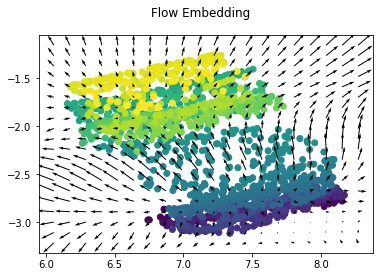

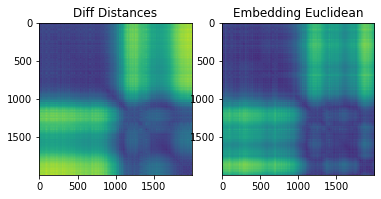

 80%|████████  | 80/100 [07:19<01:49,  5.47s/it]

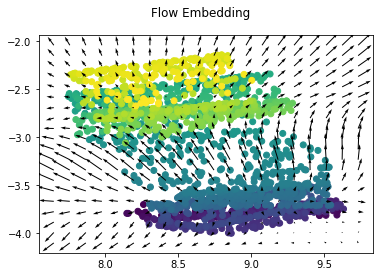

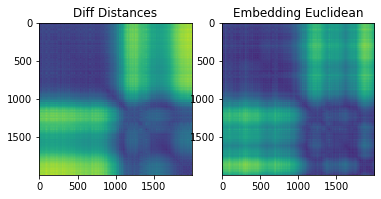

 81%|████████  | 81/100 [07:24<01:44,  5.49s/it]

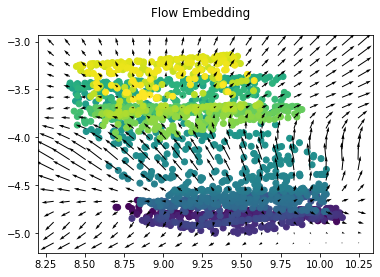

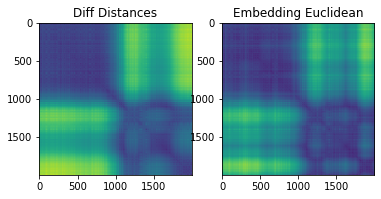

 82%|████████▏ | 82/100 [07:30<01:39,  5.54s/it]

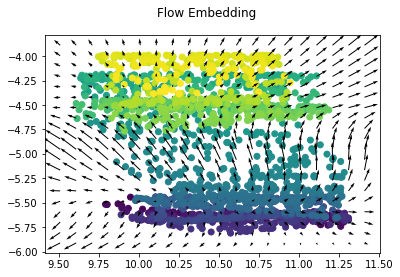

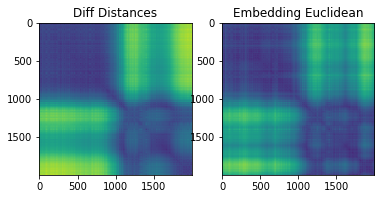

 83%|████████▎ | 83/100 [07:35<01:34,  5.53s/it]

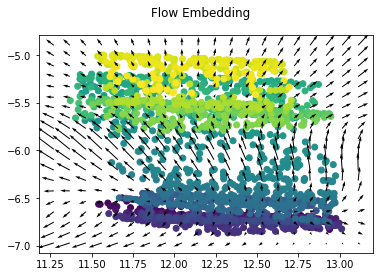

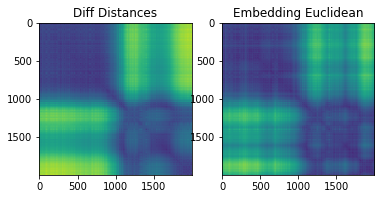

 84%|████████▍ | 84/100 [07:41<01:28,  5.51s/it]

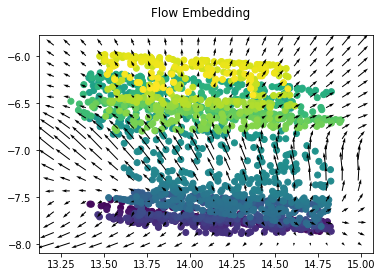

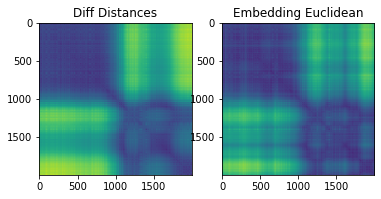

 85%|████████▌ | 85/100 [07:46<01:22,  5.51s/it]

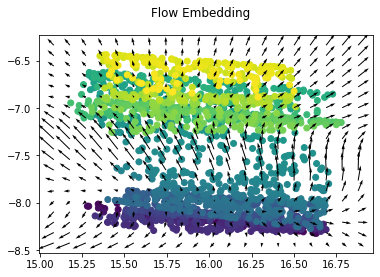

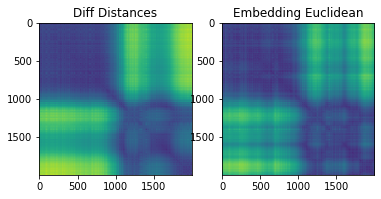

 86%|████████▌ | 86/100 [07:52<01:16,  5.49s/it]

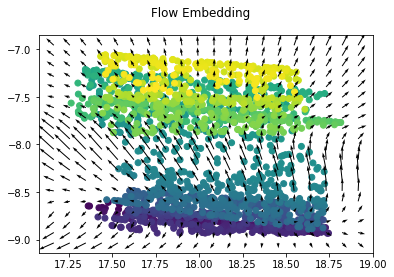

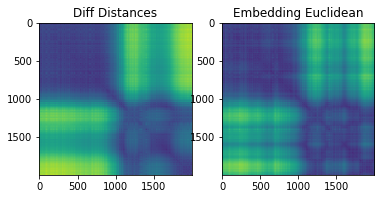

 87%|████████▋ | 87/100 [07:57<01:12,  5.58s/it]

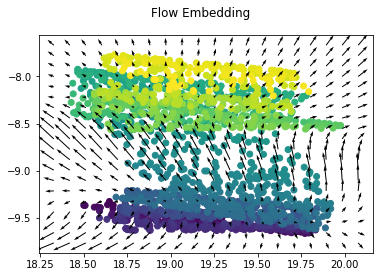

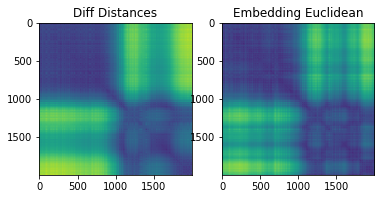

 88%|████████▊ | 88/100 [08:03<01:06,  5.54s/it]

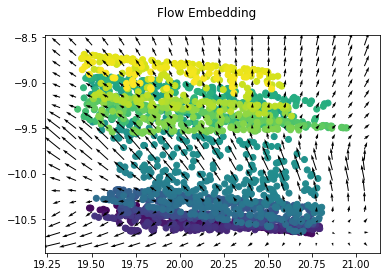

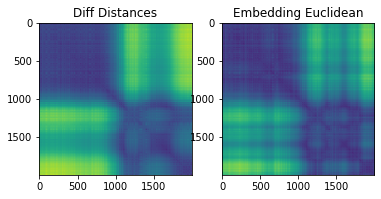

 89%|████████▉ | 89/100 [08:08<01:00,  5.52s/it]

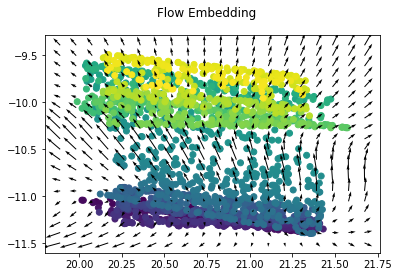

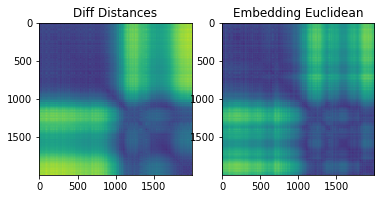

 90%|█████████ | 90/100 [08:14<00:54,  5.50s/it]

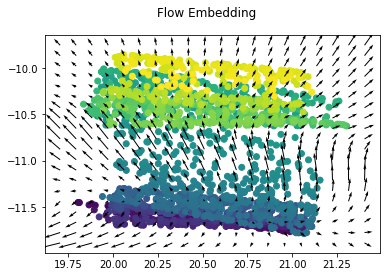

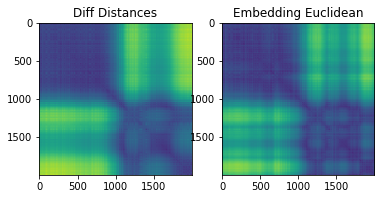

 91%|█████████ | 91/100 [08:19<00:49,  5.48s/it]

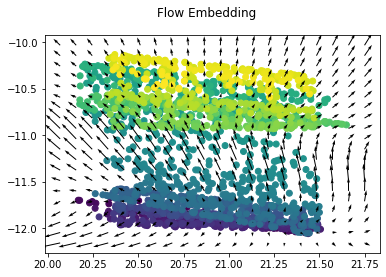

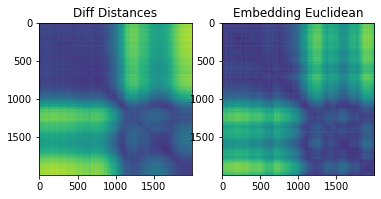

 92%|█████████▏| 92/100 [08:25<00:43,  5.48s/it]

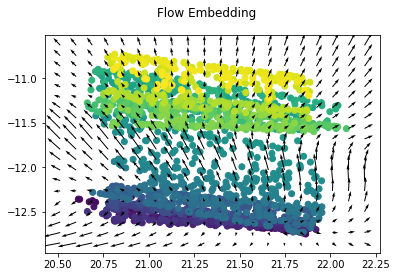

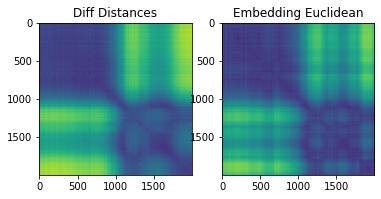

 93%|█████████▎| 93/100 [08:30<00:38,  5.49s/it]

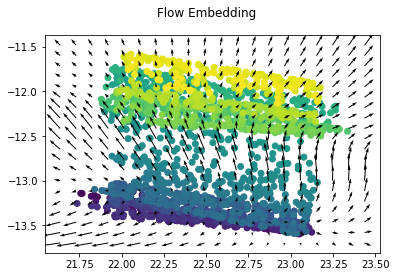

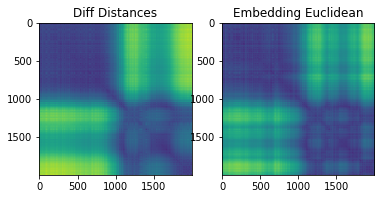

 94%|█████████▍| 94/100 [08:36<00:32,  5.48s/it]

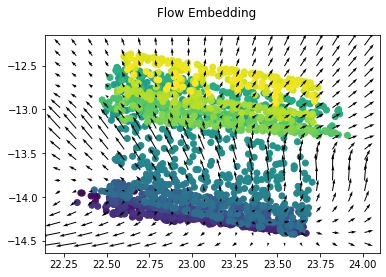

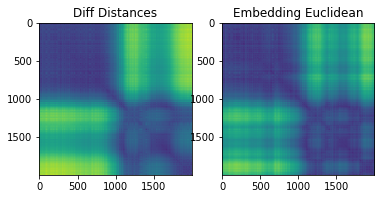

 95%|█████████▌| 95/100 [08:41<00:27,  5.49s/it]

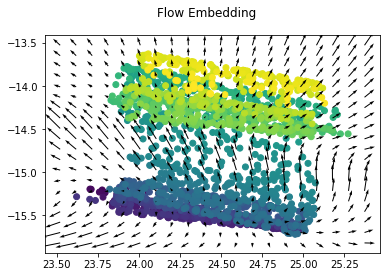

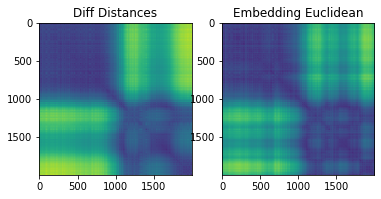

 96%|█████████▌| 96/100 [08:47<00:22,  5.57s/it]

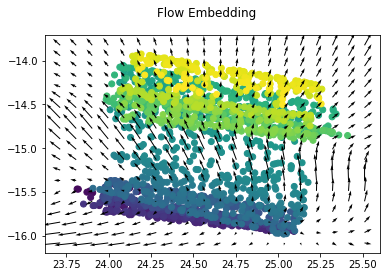

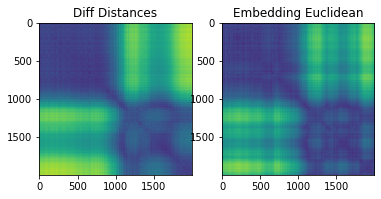

 97%|█████████▋| 97/100 [08:52<00:16,  5.54s/it]

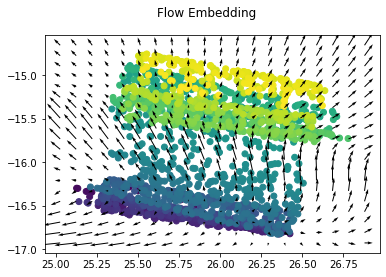

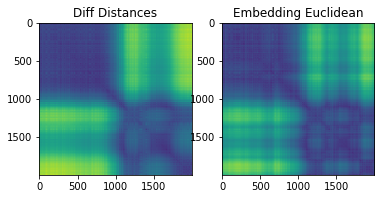

 98%|█████████▊| 98/100 [08:58<00:11,  5.51s/it]

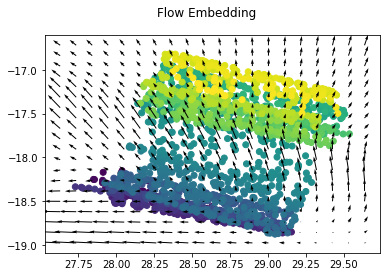

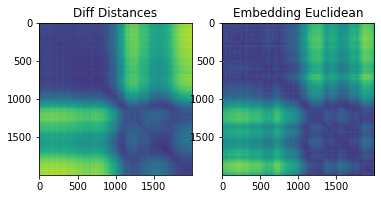

 99%|█████████▉| 99/100 [09:03<00:05,  5.50s/it]

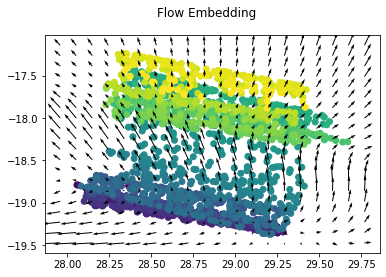

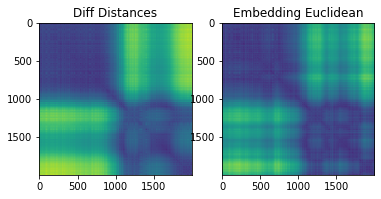

100%|██████████| 100/100 [09:09<00:00,  5.49s/it]


In [ ]:
BOBO_FET.fit()

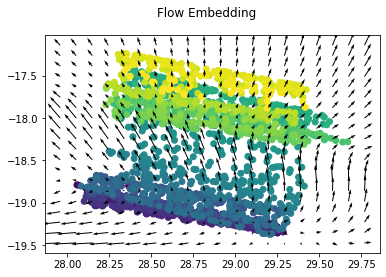

In [ ]:
BOBO_FET.visualize_embedding()

In [ ]:
BOBO_FET.training_gif(duration=400)

HTML(value='<img src="data:image/gif;base64,R0lGODlhsAEgAYcAAP///////f//+///9P//yv7///z///r///f///3//Pn//Pv/9v…

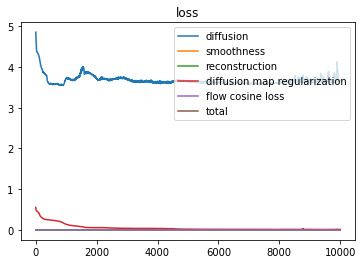

In [ ]:
BOBO_FET.visualize_loss()

In [ ]:
BOBO_FET.losses['diffusion']

100

In [ ]:
import glob
import ipywidgets as widgets
from PIL import Image
import os
import ipywidgets as widgets
import base64
frames = [Image.open(image) for image in glob.glob(f"visualizations/{BOBO_FET.timestamp}/*.jpg")]
frame_one = frames[0]
frame_one.save(f"{BOBO_FET.title}.gif", format="GIF", append_images=frames,
           save_all=True, duration=300, loop=0)
# display in jupyter notebook
b64 = base64.b64encode(open(f"{BOBO_FET.title}.gif",'rb').read()).decode('ascii')
display(widgets.HTML(f'<img src="data:image/gif;base64,{b64}" />'))

HTML(value='<img src="data:image/gif;base64,R0lGODlhsAEgAYcAAP///////f//+///+f//9P//6f//1///tP7///z///v///n///…